In [1]:
import MDAnalysis as mda
import numpy as np
import os
import pytraj as pt
from MDAnalysis.analysis import psa
import plotly.figure_factory as ff
import plotly.graph_objects as go
import numpy as np
from scipy.cluster.hierarchy import linkage
from MDAnalysis.analysis import psa
import plotly.figure_factory as ff
import plotly.graph_objects as go
import numpy as np
from scipy.cluster.hierarchy import linkage
import plotly.io as pio
import plotly.express as px

pio.templates.default = "plotly_white"

In [2]:
folders = ['2', '10', '13', '35', '56', '59', '152', '211', '223', '235', '236', '249',
           '266', '272', '290']
labels = ['10ns', '20ns', '30ns', '40ns', '50ns', '60ns', '70ns', '80ns', '90ns', '100ns', '110ns', '120ns', '130ns', '140ns', '150ns', '160ns', '170ns', '180ns', '190ns', '200ns']

In [3]:
chunk_size = 1001
#
folders = ['2', '10', '13', '35', '56', '59', '152', '211', '223', '235', '236', '249',
           '266', '272', '290']
for i in folders:
    os.chdir(f'/home/nick/Documents/200ns/100ns/{i}')
    folder = i
    trajectory_file = 'md_0_1_noPBC.xtc'
    topology_file = 'md_0_1.tpr'
    pdb_file = 'EKB1m.pdb'
    # Load the trajectory
    u = mda.Universe(topology_file, trajectory_file)
    n_frames = len(u.trajectory)
    for chunk_idx, start_frame in enumerate(range(0, n_frames, chunk_size)):
        end_frame = min(start_frame + chunk_size, n_frames)
        chunk = u.trajectory[start_frame:end_frame]
        chunk_filename = f"chunk_{chunk_idx+1}.xtc"
        with mda.Writer(chunk_filename, u.atoms.n_atoms) as w:
            for ts in chunk:
                w.write(u.atoms)
    # ca = u.select_atoms('name CA')
    # P = u.trajectory.timeseries(asel=ca, format='fac')

In [4]:
for f in folders:
    os.chdir(f'/home/nick/Documents/200ns/100ns/{f}')
    folder = f
    trajectory_file = 'md_0_1_noPBC.xtc'
    t1 = 'chunk_1.xtc'
    t2 = 'chunk_2.xtc'
    t3 = 'chunk_3.xtc'
    t4 = 'chunk_4.xtc'
    t5 = 'chunk_5.xtc'
    t6 = 'chunk_6.xtc'
    t7 = 'chunk_7.xtc'
    t8 = 'chunk_8.xtc'
    t9 = 'chunk_9.xtc'
    t10 = 'chunk_10.xtc'
    t11 = 'chunk_11.xtc'
    t12 = 'chunk_12.xtc'
    t13 = 'chunk_13.xtc'
    t14 = 'chunk_14.xtc'
    t15 = 'chunk_15.xtc'
    t16 = 'chunk_16.xtc'
    t17 = 'chunk_17.xtc'
    t18 = 'chunk_18.xtc'
    t19 = 'chunk_19.xtc'
    t20 = 'chunk_20.xtc'
    topology_file = 'md_0_1.tpr'
    pdb_file = 'EKB1m.pdb'
    uref = mda.Universe(pdb_file)
    u1 = mda.Universe(topology_file, t1)
    u2 = mda.Universe(topology_file, t2)
    u3 = mda.Universe(topology_file, t3)
    u4 = mda.Universe(topology_file, t4)
    u5 = mda.Universe(topology_file, t5)
    u6 = mda.Universe(topology_file, t6)
    u7 = mda.Universe(topology_file, t7)
    u8 = mda.Universe(topology_file, t8)
    u9 = mda.Universe(topology_file, t9)
    u10 = mda.Universe(topology_file, t10)
    u11 = mda.Universe(topology_file, t11)
    u12 = mda.Universe(topology_file, t12)
    u13 = mda.Universe(topology_file, t13)
    u14 = mda.Universe(topology_file, t14)
    u15 = mda.Universe(topology_file, t15)
    u16 = mda.Universe(topology_file, t16)
    u17 = mda.Universe(topology_file, t17)
    u18 = mda.Universe(topology_file, t18)
    u19 = mda.Universe(topology_file, t19)
    u20 = mda.Universe(topology_file, t20)
    ps = psa.PSAnalysis([u1, u2, u3, u4, u5, u6, u7, u8, u9, u10, u11, u12, u13, u14,
                     u15, u16, u17, u18, u19, u20],
                    reference=uref,
                    labels=labels)
    ps.generate_paths(align=True, save=False, weights='mass')
    ps.run(metric='hausdorff')
    matrix_h = ps.D
    fig1 = ff.create_distplot(matrix_h, labels, bin_size=.2, show_rug=False)
    fig1.show()
    fig1.write_image(f'distplot.png')
    # Initialize figure by creating upper dendrogram
    fig = ff.create_dendrogram(matrix_h, linkagefun=lambda x: linkage(matrix_h, 'ward', metric='euclidean'), orientation='bottom')

    for i in range(len(fig['data'])):
        fig['data'][i]['yaxis'] = 'y2'

    # Create Side Dendrogram
    dendro_side = ff.create_dendrogram(matrix_h, linkagefun=lambda x: linkage(matrix_h, 'ward', metric='euclidean'), orientation='right')
    for i in range(len(dendro_side['data'])):
        dendro_side['data'][i]['xaxis'] = 'x2'

    # Add Side Dendrogram Data to Figure
    for data in dendro_side['data']:
        fig.add_trace(data)

    heatmap = [
        go.Heatmap(
            z=matrix_h,
            colorscale='Greens',  # set the color scale to greens
            autocolorscale=True,
            reversescale=False,
            x = labels
        )
    ]

    heatmap[0]['x'] = fig['layout']['xaxis']['tickvals']
    heatmap[0]['y'] = dendro_side['layout']['yaxis']['tickvals']

    # Add Heatmap Data to Figure
    for data in heatmap:
        fig.add_trace(data)

    # Edit Layout
    fig.update_layout({
        'width':1000,
        'height':750,
        'showlegend':False,
        'hovermode':'closest',
    })

    # Edit xaxis
    fig.update_layout(xaxis={
        'domain': [.2, 1],
        'mirror': False,
        'showgrid': False,
        'showline': False,
        'zeroline': False,
        'tickvals': list(range(10, 201, 10)),
        'ticktext': list(range(10, 201, 10)),
        'title': 'Hausdorff Distance Among 10ns Trajectories Chunks',
    })

    # Edit xaxis2
    fig.update_layout(xaxis2={
        'domain': [0, .15],
        'mirror': False,
        'showgrid': False,
        'showline': False,
        'zeroline': False,
        'showticklabels': False,
        'ticks': "",
        'position': 0.9
    })

    # Edit yaxis
    fig.update_layout(yaxis={
        'domain': [0, .7],
        'mirror': False,
        'showgrid': False,
        'showline': False,
        'zeroline': False,
        'showticklabels': True,
        'tickvals': list(range(10, 201, 10)),
        'ticktext': list(range(10, 201, 10)),
    })


    # Edit yaxis2
    fig.update_layout(yaxis2={
        'domain':[0.725, 0.975],
        'mirror': False,
        'showgrid': False,
        'showline': False,
        'zeroline': False,
        'showticklabels': False,
        'ticks': "",
        'position': 0.9
    })

    fig.show()
    fig.write_image(f'dendrogram.png')

/tmp/ipykernel_60089/1394471629.py:59: ClusterWarning:

scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix

/tmp/ipykernel_60089/1394471629.py:65: ClusterWarning:

scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix



In [46]:
# ps.generate_paths(align=True, save=False, weights='mass')

/usr/ulocal/anaconda3/envs/mdthings/lib/python3.8/site-packages/MDAnalysis/coordinates/XDR.py:241: UserWarning: Reload offsets from trajectory
 ctime or size or n_atoms did not match
  warnings.warn("Reload offsets from trajectory\n "


In [47]:
# ps.run(metric='hausdorff')

<Figure size 640x480 with 0 Axes>

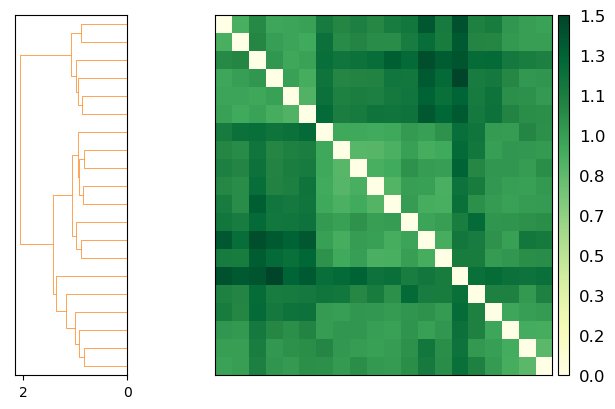

In [48]:
# import matplotlib.pyplot as plt
# ps.plot(linkage='ward')
# plt.savefig(f'/home/nick/Documents/200ns/100ns.3/{i}/hausdorff.png')

In [59]:
# matrix_h = ps.D

In [71]:
# import plotly.figure_factory as ff
# import plotly.graph_objects as go
# import numpy as np
# import pandas as pd
# import plotly.express as px
# import plotly.io as pio
# fig = ff.create_distplot(matrix_h, labels, bin_size=.2, show_rug=False)
#
# fig.show()
# fig.save(f'/home/nick/Documents/200ns/100ns.3/{i}/distplot.html')

In [169]:
# import plotly.figure_factory as ff
# import plotly.graph_objects as go
# import numpy as np
# from scipy.cluster.hierarchy import linkage
#
# # Initialize figure by creating upper dendrogram
# fig = ff.create_dendrogram(matrix_h, linkagefun=lambda x: linkage(matrix_h, 'ward', metric='euclidean'), orientation='bottom')
#
# for i in range(len(fig['data'])):
#     fig['data'][i]['yaxis'] = 'y2'
#
# # Create Side Dendrogram
# dendro_side = ff.create_dendrogram(matrix_h, linkagefun=lambda x: linkage(matrix_h, 'ward', metric='euclidean'), orientation='right')
# for i in range(len(dendro_side['data'])):
#     dendro_side['data'][i]['xaxis'] = 'x2'
#
# # Add Side Dendrogram Data to Figure
# for data in dendro_side['data']:
#     fig.add_trace(data)
#
# heatmap = [
#     go.Heatmap(
#         z=matrix_h,
#         colorscale='Greens',  # set the color scale to greens
#         autocolorscale=True,
#         reversescale=False,
#         x = labels
#     )
# ]
#
# heatmap[0]['x'] = fig['layout']['xaxis']['tickvals']
# heatmap[0]['y'] = dendro_side['layout']['yaxis']['tickvals']
#
# # Add Heatmap Data to Figure
# for data in heatmap:
#     fig.add_trace(data)
#
# # Edit Layout
# fig.update_layout({
#     'width':1000,
#     'height':750,
#     'showlegend':False,
#     'hovermode':'closest',
# })
#
# # Edit xaxis
# fig.update_layout(xaxis={
#     'domain': [.2, 1],
#     'mirror': False,
#     'showgrid': False,
#     'showline': False,
#     'zeroline': False,
#     'tickvals': list(range(10, 201, 10)),
#     'ticktext': list(range(10, 201, 10)),
#     'title': 'Hausdorff Distance Among 10ns Trajectories Chunks',
# })
#
# # Edit xaxis2
# fig.update_layout(xaxis2={
#     'domain': [0, .15],
#     'mirror': False,
#     'showgrid': False,
#     'showline': False,
#     'zeroline': False,
#     'showticklabels': False,
#     'ticks': "",
#     'position': 0.9
# })
#
# # Edit yaxis
# fig.update_layout(yaxis={
#     'domain': [0, .7],
#     'mirror': False,
#     'showgrid': False,
#     'showline': False,
#     'zeroline': False,
#     'showticklabels': True,
#     'tickvals': list(range(10, 201, 10)),
#     'ticktext': list(range(10, 201, 10)),
# })
#
#
# # Edit yaxis2
# fig.update_layout(yaxis2={
#     'domain':[0.725, 0.975],
#     'mirror': False,
#     'showgrid': False,
#     'showline': False,
#     'zeroline': False,
#     'showticklabels': False,
#     'ticks': "",
#     'position': 0.9
# })
#
# fig.show()


/tmp/ipykernel_19156/3830909974.py:7: ClusterWarning:

scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix

/tmp/ipykernel_19156/3830909974.py:13: ClusterWarning:

scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix

